# Prac 03. Part 1

For this homework you are going to implement the **unsharp masking** filter (USM). It is a technique to improve the sharpness of an image by combining the image with its blurred (unsharp) version. See the Wikipedia [page](https://en.wikipedia.org/wiki/Unsharp_masking) for more details.

### Unsharp Masking (USP)
The USM technique consists of the following steps:
* Load the image you will be working with.
* Create a blurred (unsharp) version of the original image.
* Add the unsharp image (with a certain **weight**) to the original.

To sum it up, the USM performs the following operation:

`sharpened = original + (original − unsharp) × amount`

Even though we provide you an image to work with, you are welcome to use your own images :-)

In [1]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import Image

In [2]:
plt.rcParams['figure.figsize'] = [15, 10]

In [3]:
img = cv2.imread('kodim01.png')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

In [4]:
# Create a blurred (unsharp) version of the original image (you can use Gaussian blurring)
unsharp = cv2.GaussianBlur(img, (5,5), sigmaX=1.0)

In [5]:
# Create the difference image (original − unsharp)
# Note: Remember that you are working with uint8 data types. Any addition or substractions
# might result in overflow or underflow, respectively. You can prevent this by casting the images to float.
orig_f = img.astype(np.float32)
unsharp_f = unsharp.astype(np.float32)
diff = orig_f - unsharp_f

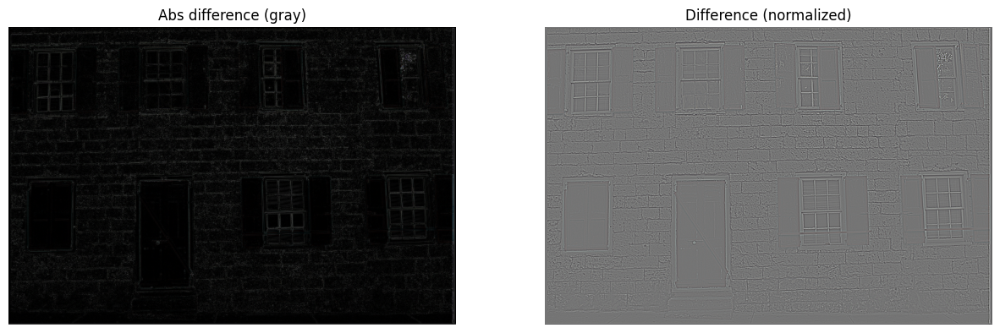

In [6]:
plt.figure(figsize=(15,6))
plt.subplot(1,2,1)
plt.title("Abs difference (gray)")
plt.imshow(np.abs(diff).astype(np.uint8), cmap="gray")
plt.axis("off")

diff_norm = diff - diff.min()
diff_norm = diff_norm / diff_norm.max() * 255
diff_norm = diff_norm.astype(np.uint8)

plt.subplot(1,2,2)
plt.title("Difference (normalized)")
plt.imshow(diff_norm)
plt.axis("off")

plt.show()

In [7]:
# Apply USM to get the resulting image using `sharpened = original + (original − unsharp) × amount`
# Note: Again, take care of underflows/overflows if necessary.
amount = 1.5
sharpened = img.astype(np.float32) + diff * amount
sharpened = np.clip(sharpened, 0, 255).astype(np.uint8)

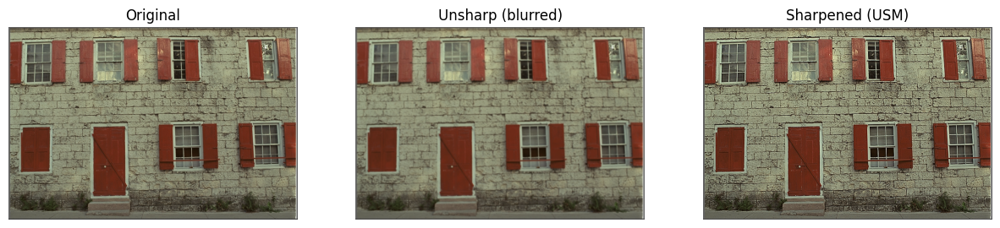

In [8]:
plt.figure(figsize=(15,10))
plt.subplot(1,3,1)
plt.title("Original")
plt.imshow(img)
plt.axis("off")

plt.subplot(1,3,2)
plt.title("Unsharp (blurred)")
plt.imshow(unsharp)
plt.axis("off")

plt.subplot(1,3,3)
plt.title("Sharpened (USM)")
plt.imshow(sharpened)
plt.axis("off")
plt.show()

# Prac 03. Part 2  

## Завдання  

Виконати проєктування програмного додатку для PC, який:  


### **a. Інвертування кольорової інтенсивності**
- Виконує інвертування пікселів завантаженого користувачем зображення.  
- Вивести вхідне та отримане зображення.  



### **b. Модифікація однієї з компонент**
- Для деякої (однієї з трьох) компонент виконує зміну, наприклад:  
  додає до кожного пікселя постійне значення.  
- Вивести усі зображення в об’єкти типу *ImageView*.  



### **c. Розбиття на компоненти**
- Виконує розкладання зображення на канали: **Red, Green та Blue**.  



### **d. Злиття двох зображень**
- Виконує «злиття» двох зображень у певних пропорціях (долях від одиниці).  
- Наприклад, якщо вклад першого зображення у нове складає 0.4,  
  то вклад другого – 1 − 0.4 = 0.6.  

Формула:  

$$
\mathrm{Image}_{\text{new}} = \alpha \cdot \mathrm{Image}_1 + (1-\alpha)\cdot \mathrm{Image}_2
$$

- За додаткові бали: передбачити змінну величину alpha in (0;1), крок зміни обрати самостійно.  
- Вивести анімацію зміни alpha.  



### **e. Фільтрація зображення**
Застосувати матричні фільтри (згідно лабораторної):  
- фільтр розмиття,  
- фільтр поліпшення чіткості,  
- медіанний фільтр,  
- фільтр ерозії,  
- фільтр нарощування,  
- фільтр Собеля.  



### **f. Вбудовування водяного знаку**
- Перетворити водяний знак у бінарне (чорно-біле) зображення.  
- Використати метод **LSB** (найменш значущого біта).  
- Параметр «номер бітової площини» (<9) вивести на форму головного вікна.  
- Водяний знак вбудовувати у канал **Blue**.  
- Якщо розміри різні:  
  - контейнер > знак → виконати циклічне замощення;  
  - контейнер < знак → обрізати та вбудувати частину водяного знаку.  


### **g. Витягування водяного знаку (додатково)**
- Реалізувати метод вилучення водяного знаку з контейнера (перевірка завдання f).  


## Завдання (a) Інвертування кольорової інтенсивності

In [9]:
img = cv2.imread('kodim07.png')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
inverted = 255 - img

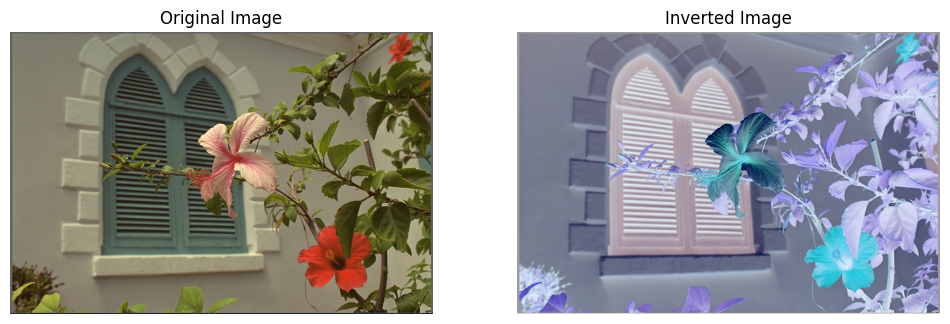

In [10]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(img)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title("Inverted Image")
plt.imshow(inverted)
plt.axis("off")

plt.show()

## Завдання (b) Модифікація однієї компоненти

In [11]:
img = cv2.imread('kodim01.png')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

In [12]:
k = 100

mods = []

"""
for ch in range(3):  # 0=R, 1=G, 2=B
    mod = img.copy()
    mod[:,:,ch] = np.clip(mod[:,:,ch] + k, 0, 255)
    mods.append(mod)
"""

for ch in range(3):
    mod = img.copy().astype(np.float32)

    channel = mod[:,:,ch] + k
    channel = 255 * (channel / channel.max())

    mod[:,:,ch] = channel
    mods.append(mod.astype(np.uint8))

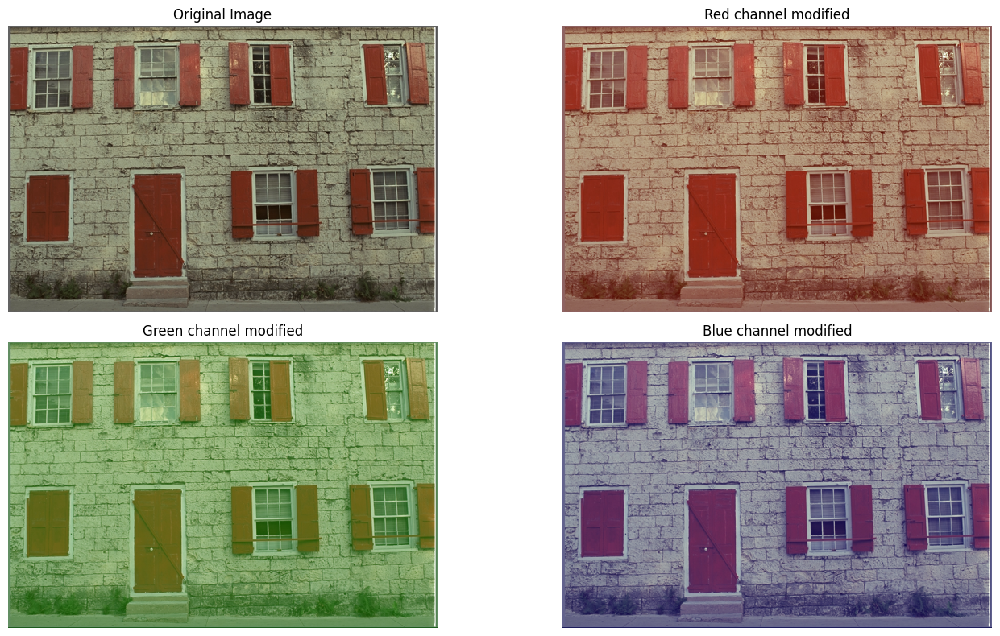

In [13]:
plt.figure(figsize=(15,8))

plt.subplot(2,2,1)
plt.title("Original Image")
plt.imshow(img)
plt.axis("off")

plt.subplot(2,2,2)
plt.title("Red channel modified")
plt.imshow(mods[0])
plt.axis("off")

plt.subplot(2,2,3)
plt.title("Green channel modified")
plt.imshow(mods[1])
plt.axis("off")

plt.subplot(2,2,4)
plt.title("Blue channel modified")
plt.imshow(mods[2])
plt.axis("off")

plt.tight_layout()
plt.show()

## Завдання (c) Розбиття на компоненти RGB

In [14]:
img = cv2.imread('kodim21.png')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

In [15]:
zeros = np.zeros_like(img[:,:,0])

R_colored = np.stack([img[:,:,0], zeros, zeros], axis=-1)
G_colored = np.stack([zeros, img[:,:,1], zeros], axis=-1)
B_colored = np.stack([zeros, zeros, img[:,:,2]], axis=-1)

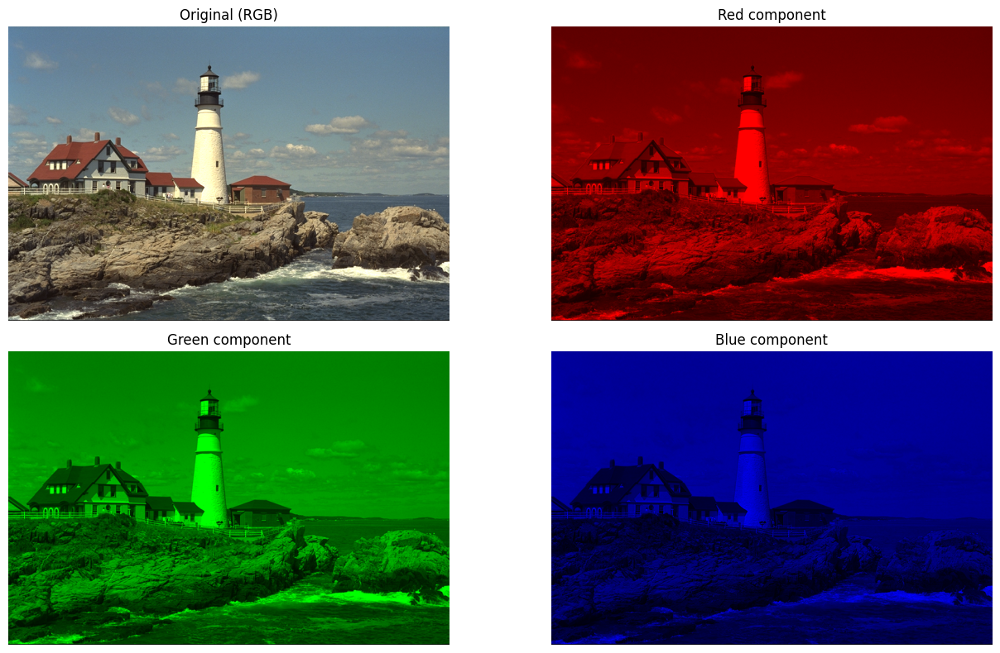

In [16]:
plt.figure(figsize=(14,8))

plt.subplot(2,2,1)
plt.title("Original (RGB)")
plt.imshow(img)
plt.axis("off")

plt.subplot(2,2,2)
plt.title("Red component")
plt.imshow(R_colored)
plt.axis("off")

plt.subplot(2,2,3)
plt.title("Green component")
plt.imshow(G_colored)
plt.axis("off")

plt.subplot(2,2,4)
plt.title("Blue component")
plt.imshow(B_colored)
plt.axis("off")

plt.tight_layout()
plt.show()

## Завдання (d) Злиття двох зображень

In [17]:
img1 = cv2.imread('kodim01.png')
img2 = cv2.imread('kodim21.png')

In [18]:
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

if img1.shape != img2.shape:
    img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0]))

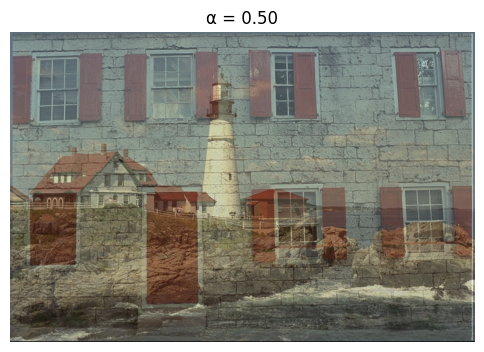

In [19]:
alpha = 0.5
blended = alpha * img1 + (1 - alpha) * img2
blended = np.clip(blended, 0, 255).astype(np.uint8)

plt.figure(figsize=(6,6))
plt.imshow(blended)
plt.title("α = 0.50")
plt.axis("off")
plt.show()

In [25]:
# fig, ax = plt.subplots(figsize=(6,6))
# im = ax.imshow(img1)
# ax.axis("off")

def update(frame):
    alpha = frame / 100.0
    weighted_img1 = alpha * img1
    weighted_img2 = (1.0 - alpha) * img2
    blended = weighted_img1 + weighted_img2
    bounded = np.clip(blended, 0, 255)
    final_image = bounded.astype(np.uint8)
    im.set_array(final_image)
    ax.set_title("α = {:.2f}".format(alpha))
    return [im]

anim = FuncAnimation(fig, update, frames=101, interval=100, blit=True)
anim.save("blend.gif", writer=PillowWriter(fps=10))

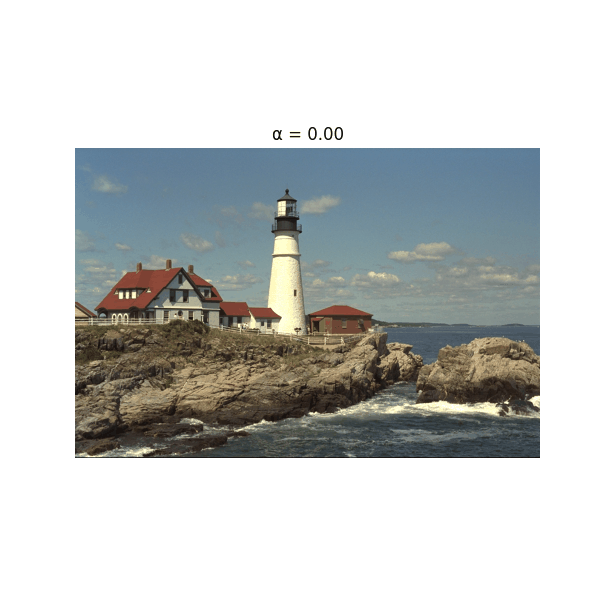

In [26]:
Image(filename="blend.gif")

## Завдання (e) Фільтрація зображень

In [27]:
img = cv2.imread('kodim07.png')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

In [28]:
def convolution(image, kernel):
    height, width, channels = image.shape
    ksize = kernel.shape[0]
    k = ksize // 2

    result = np.zeros((height, width, channels), dtype=np.float64)

    padded = np.pad(image, ((k, k), (k, k), (0,0)), mode="edge")

    for c in range(channels):
        for i in range(height):
            for j in range(width):
                value = 0.0
                for u in range(ksize):
                    for v in range(ksize):
                        pixel = padded[i+u, j+v, c]
                        coeff = kernel[u, v]
                        value += pixel * coeff
                result[i, j, c] = value

    return np.clip(result, 0, 255).astype(np.uint8)

In [29]:
def gaussian_kernel(size=5, sigma=1.0):
    k = size // 2
    kernel = np.zeros((size, size), dtype=np.float64)

    for x in range(-k, k+1):
        for y in range(-k, k+1):
            kernel[x+k, y+k] = np.exp(-(x**2 + y**2) / (2 * sigma**2))

    s = np.sum(kernel)
    kernel = kernel / s
    return kernel

In [30]:
K = gaussian_kernel(size=5, sigma=1.0)
blurred = convolution(img, K)

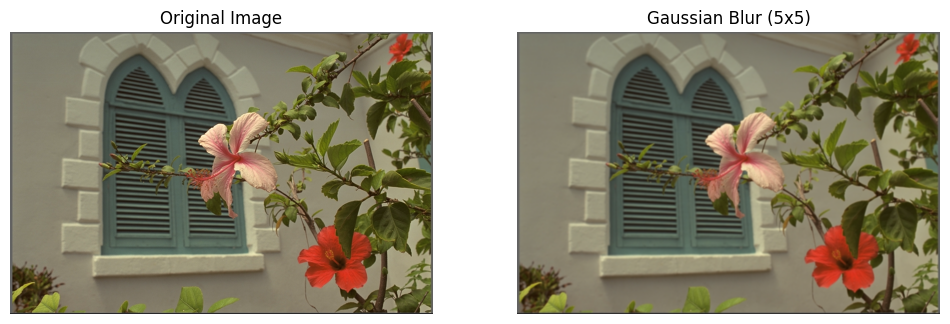

In [31]:
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.title("Original Image")
plt.imshow(img)
plt.axis("off")

plt.subplot(1,2,2)
plt.title("Gaussian Blur (5x5)")
plt.imshow(blurred)
plt.axis("off")

plt.show()

In [32]:
def sharpening_kernel():
    return np.array([[0, -1,  0],
                     [-1,  5, -1],
                     [0, -1,  0]], dtype=np.float64)

In [33]:
K = sharpening_kernel()
sharpened = convolution(img, K)

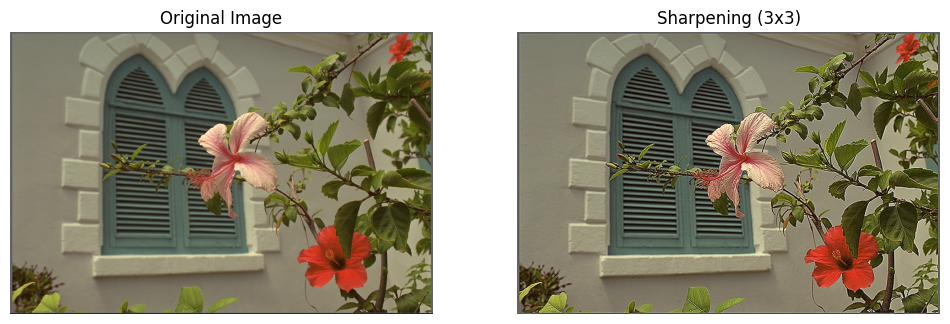

In [34]:
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.title("Original Image")
plt.imshow(img)
plt.axis("off")

plt.subplot(1,2,2)
plt.title("Sharpening (3x3)")
plt.imshow(sharpened)
plt.axis("off")

plt.show()

In [35]:
def median_filter(image, size=3):
    height, width, channels = image.shape
    k = size // 2

    result = np.zeros_like(image, dtype=np.uint8)

    padded = np.pad(image, ((k, k), (k, k), (0,0)), mode="edge")

    for c in range(channels):
        for i in range(height):
            for j in range(width):
                region = padded[i:i+size, j:j+size, c].flatten()
                median_val = np.median(region)
                result[i, j, c] = median_val

    return result

In [36]:
medianed = median_filter(img, size=3)

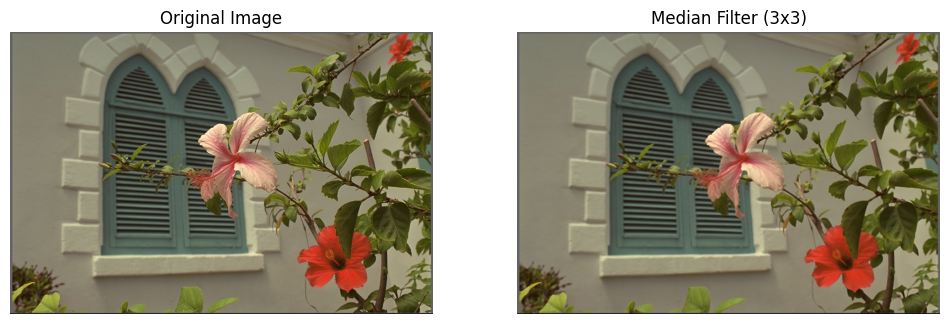

In [37]:
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.title("Original Image")
plt.imshow(img)
plt.axis("off")

plt.subplot(1,2,2)
plt.title("Median Filter (3x3)")
plt.imshow(medianed)
plt.axis("off")

plt.show()

In [38]:
img = cv2.imread('kodim01.png')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

In [39]:
def erosion(image, size=3):
    height, width, channels = image.shape
    k = size // 2

    result = np.zeros_like(image, dtype=np.uint8)

    padded = np.pad(image, ((k, k), (k, k), (0,0)), mode="edge")

    for c in range(channels):
        for i in range(height):
            for j in range(width):
                region = padded[i:i+size, j:j+size, c].flatten()
                result[i, j, c] = np.min(region)

    return result

In [40]:
eroded = erosion(img, size=3)

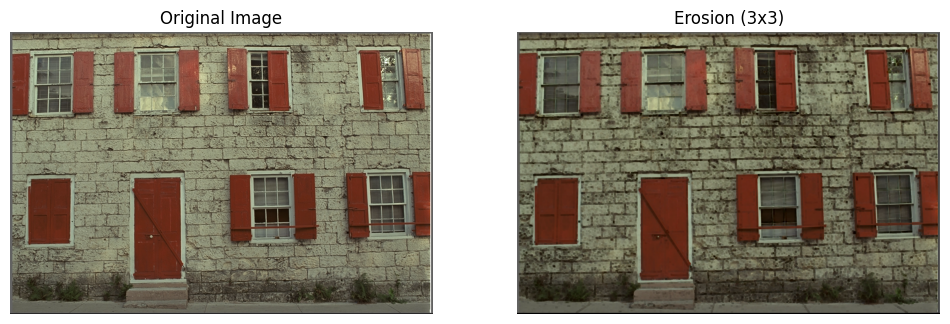

In [41]:
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.title("Original Image")
plt.imshow(img)
plt.axis("off")

plt.subplot(1,2,2)
plt.title("Erosion (3x3)")
plt.imshow(eroded)
plt.axis("off")

plt.show()

In [42]:
def dilation(image, size=3):
    height, width, channels = image.shape
    k = size // 2

    result = np.zeros_like(image, dtype=np.uint8)

    padded = np.pad(image, ((k, k), (k, k), (0,0)), mode="edge")

    for c in range(channels):
        for i in range(height):
            for j in range(width):
                region = padded[i:i+size, j:j+size, c].flatten()
                result[i, j, c] = np.max(region)

    return result

In [43]:
dilated = dilation(img, size=3)

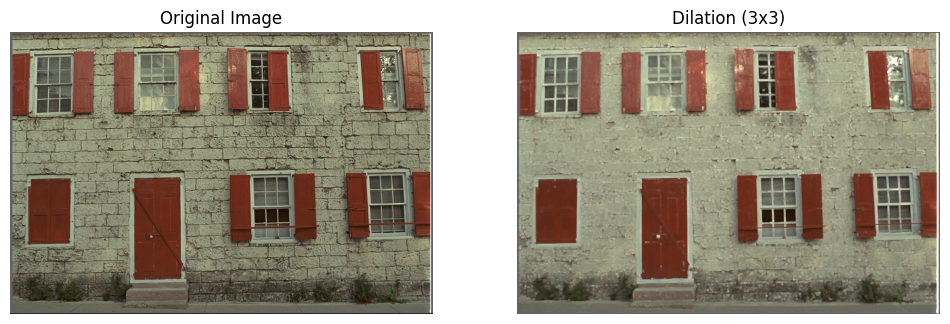

In [44]:
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.title("Original Image")
plt.imshow(img)
plt.axis("off")

plt.subplot(1,2,2)
plt.title("Dilation (3x3)")
plt.imshow(dilated)
plt.axis("off")

plt.show()

In [45]:
img = cv2.imread('kodim21.png')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

In [46]:
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

Gx_kernel = np.array([[-1, 0, 1],
                      [-2, 0, 2],
                      [-1, 0, 1]], dtype=np.float64)

Gy_kernel = np.array([[-1, -2, -1],
                      [ 0,  0,  0],
                      [ 1,  2,  1]], dtype=np.float64)

In [47]:
def convolution_sobel(image, kernel):
    height, width = image.shape
    ksize = kernel.shape[0]
    k = ksize // 2

    result = np.zeros((height, width), dtype=np.float64)
    padded = np.pad(image, ((k, k), (k, k)), mode="edge")

    for i in range(height):
        for j in range(width):
            value = 0.0
            for u in range(ksize):
                for v in range(ksize):
                    pixel = padded[i+u, j+v]
                    coeff = kernel[u, v]
                    value += pixel * coeff
            result[i, j] = value

    return result

In [48]:
Gx = convolution_sobel(gray, Gx_kernel)
Gy = convolution_sobel(gray, Gy_kernel)

G = np.sqrt(Gx**2 + Gy**2)
G = np.clip(G, 0, 255).astype(np.uint8)

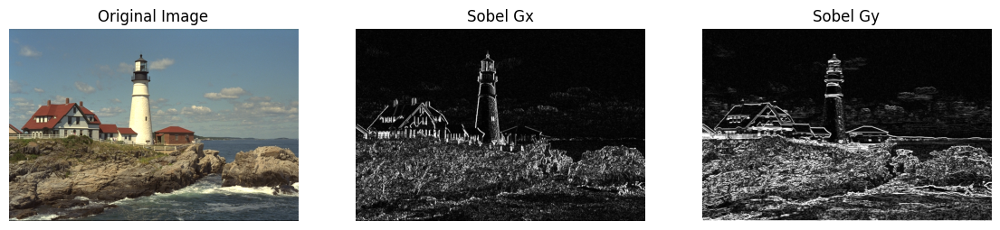

In [49]:
plt.figure(figsize=(14,6))
plt.subplot(1,3,1)
plt.title("Original Image")
plt.imshow(img)
plt.axis("off")

plt.subplot(1,3,2)
plt.title("Sobel Gx")
plt.imshow(np.clip(np.abs(Gx), 0, 255).astype(np.uint8), cmap='gray')
plt.axis("off")

plt.subplot(1,3,3)
plt.title("Sobel Gy")
plt.imshow(np.clip(np.abs(Gy), 0, 255).astype(np.uint8), cmap='gray')
plt.axis("off")

plt.show()

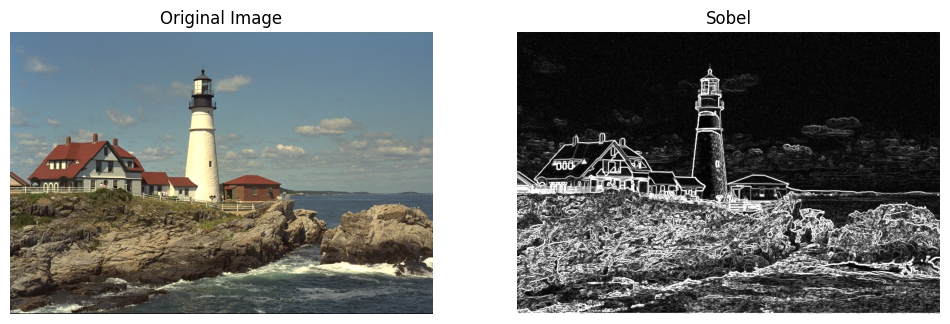

In [51]:
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.title("Original Image")
plt.imshow(img)
plt.axis("off")

plt.subplot(1,2,2)
plt.title("Sobel")
plt.imshow(np.clip(G, 0, 255).astype(np.uint8), cmap='gray')
plt.axis("off")

plt.show()

## Завдання (f) Вбудовування водяного знаку

In [52]:
C = cv2.imread("kodim07.png")
C = cv2.cvtColor(C, cv2.COLOR_BGR2RGB)
W = cv2.imread("image_2024-05-17_01-45-24.png", cv2.IMREAD_GRAYSCALE)

In [53]:
Hc, Wc, _ = C.shape
Hw, Ww = W.shape
Wb = np.zeros((Hw, Ww), dtype=np.uint8)
for i in range(Hw):
    for j in range(Ww):
        if W[i, j] > 127:
            Wb[i, j] = 1
        else:
            Wb[i, j] = 0

W_resized = np.zeros((Hc, Wc), dtype=np.uint8)
for i in range(Hc):
    for j in range(Wc):
        W_resized[i, j] = Wb[i % Hw, j % Ww]

In [54]:
def embed_lsb(C, W, p=1):
    H, Wc, _ = C.shape
    R = C.copy()

    for i in range(H):
        for j in range(Wc):
            B = int(C[i, j, 2])
            w = int(W[i, j])


            higher = (B // (1 << p)) * (1 << p)
            lower  = B % (1 << (p-1))
            B_clear = higher + lower

            B_new = B_clear + (w << (p-1))

            R[i, j, 2] = B_new
    return R

def extract_lsb(Cw, p=1):
    H, W, _ = Cw.shape
    W_extracted = np.zeros((H, W), dtype=np.uint8)

    for i in range(H):
        for j in range(W):
            B = int(Cw[i, j, 2])
            w = (B >> (p-1)) % 2
            W_extracted[i, j] = w
    return W_extracted

In [60]:
p = 2
Cw = embed_lsb(C, W_resized, p)

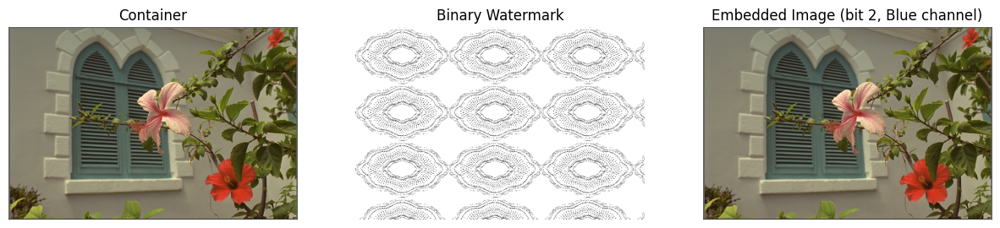

In [56]:
plt.figure(figsize=(15,6))

plt.subplot(1,3,1)
plt.title("Container")
plt.imshow(C)
plt.axis("off")

plt.subplot(1,3,2)
plt.title("Binary Watermark")
plt.imshow(W_resized*255, cmap="gray")
plt.axis("off")

plt.subplot(1,3,3)
plt.title(f"Embedded Image (bit {p}, Blue channel)")
plt.imshow(Cw)
plt.axis("off")

plt.show()

## Завдання (g) Витягування водяного знаку

In [57]:
W_back = extract_lsb(Cw, p)

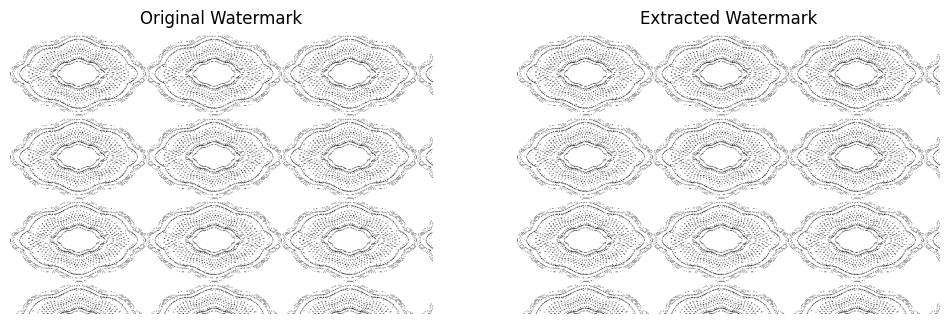

In [62]:
plt.figure(figsize=(12,5))

plt.subplot(1,2,1)
plt.title("Original Watermark")
plt.imshow(W_resized*255, cmap="gray")
plt.axis("off")

plt.subplot(1,2,2)
plt.title("Extracted Watermark")
plt.imshow(W_back*255, cmap="gray")
plt.axis("off")

plt.show()